### 画像の読み込み

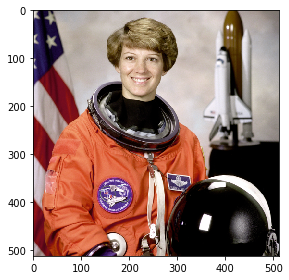

In [2]:
import skimage

img = skimage.data.astronaut()
skimage.io.imshow(img)

### 顔領域をクロップ

[159, 52, 290, 183]


/opt/conda/lib/python3.8/site-packages/torch/nn/functional.py:780: UserWarning:

Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.



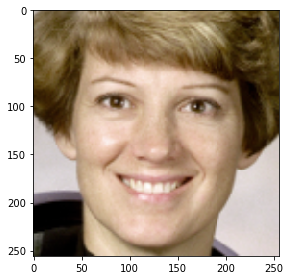

In [3]:
from facenet_pytorch import MTCNN
import numpy as np
from core import utils
import cv2 

device="cuda:0"

mtcnn = MTCNN(device=device, select_largest=False)

bboxes, probs = mtcnn.detect(img)

bbox = bboxes[0]
# bbox = np.round(bbox).astype(np.int)
bbox = utils.pad_bbox(bbox, img.shape[:2], 0.2)
print(bbox)

face_img = img[bbox[1]:bbox[3], bbox[0]:bbox[2], :]
face_img = cv2.resize(face_img, (256, 256))

skimage.io.imshow(face_img)

### 顔の特徴点を取得(face-alignment)

(68, 3)


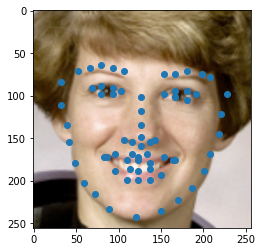

In [4]:
import face_alignment
import matplotlib.pyplot as plt

fa = face_alignment.FaceAlignment(
        face_alignment.LandmarksType._3D, flip_input=False)

lms = fa.get_landmarks_from_image(face_img)[0]

plt.imshow(face_img)
print(lms.shape)
x, y, z = lms.T
plt.scatter(x, y)
plt.show()

### 3DMMの読み込みとメッシュの表示

In [5]:
from scipy.io import loadmat
import plotly.graph_objects as go

# 3DMMデータの読み込み
model_path = 'BFM/BFM09_model_info.mat'
model_dict = loadmat(model_path)
for k, v in model_dict.items():
    if isinstance(v, np.ndarray):
        print(k, v.shape)

kp_inds = (model_dict['keypoints'] - 1).reshape(-1).astype(np.int32)
meanshape = model_dict['meanshape']
tri = model_dict['tri'] - 1
meantex = model_dict['meantex'].reshape(-1, 3)

# 顔メッシュの表示
vertices = meanshape.reshape(-1, 3)
x, y, z = vertices.T 
i, j, k = tri.T
fig = go.Figure(
    go.Mesh3d(
        x=x, y=y, z=z, i=i, j=j, k=k, vertexcolor=meantex
    )
)

# 特徴点の可視化
model_lms_pts = meanshape.reshape(-1, 3)[kp_inds]
x, y, z = model_lms_pts.T
fig.add_trace(
    go.Scatter3d(
        x=x, y=y, z=z, mode='markers', marker=dict(size=1)
    )
)
fig.show()

dict_keys(['__header__', '__version__', '__globals__', 'meanshape', 'meantex', 'idBase', 'exBase', 'texBase', 'tri', 'point_buf', 'tri_mask2', 'keypoints', 'frontmask2_idx', 'skinmask'])
meanshape (1, 107127)
meantex (1, 107127)
idBase (107127, 80)
exBase (107127, 64)
texBase (107127, 80)
tri (70789, 3)
point_buf (35709, 8)
tri_mask2 (54681, 3)
keypoints (1, 68)
frontmask2_idx (27660, 1)
skinmask (1, 35709)


### opencvのSolvePnPを用いて， カメラの外部パラメータを計算

In [56]:
import cv2
from scipy.spatial.transform import Rotation as R
import matplotlib.pyplot as plt

# 内部パラメータ行列を設定
K = np.eye(3)
K[0, 0] = 1024
K[1, 1] = 1024
K[:2, 2] = [128, 128]
# distortionを設定
dist_coefficients = np.zeros(4)

# opencvのsolvePnPを用いてカメラの外部パラメータ(回転，並進)を計算
ret, rvec, tvec = cv2.solvePnP(model_lms_pts, lms[..., :2].astype(np.double), K, dist_coefficients)

rmat = R.from_rotvec(rvec[..., 0]).as_matrix()
Rt = np.concatenate([rmat, tvec], axis=1)

# モデルの特徴点をイメージスペースに投影
model_lms_pts_homo = np.concatenate([model_lms_pts, np.ones_like(model_lms_pts)[..., 0:1]], axis=1)
model_lms_pts_camera = K @ Rt @ model_lms_pts_homo.T
model_lms_pts_image = model_lms_pts_camera[:2] / model_lms_pts_camera[2] 

plt.imshow(face_img)
# 特徴点をプロット
plt.scatter(lms[:, 0], lms[:, 1])
# モデルの特徴点をプロット
plt.scatter(model_lms_pts_image[0], model_lms_pts_image[1])
plt.show()

<IPython.core.display.Javascript object>

### pytorch3dを用いてメッシュをレンダリング

In [57]:
import torch
from pytorch3d.structures import Meshes
from pytorch3d.structures.meshes import join_meshes_as_scene
from pytorch3d.renderer import (
    look_at_view_transform,
    PerspectiveCameras,
    FoVPerspectiveCameras,
    PointLights,
    DirectionalLights,
    RasterizationSettings,
    MeshRenderer,
    MeshRasterizer,
    SoftPhongShader,
    TexturesVertex,
    blending
)
from pytorch3d.utils import ico_sphere, cameras_from_opencv_projection
from pytorch3d.io import load_objs_as_meshes, load_obj


def toTensor(array, requires_grad=False, device='cuda:0'):
    return torch.tensor(array, dtype=torch.float32, requires_grad=requires_grad, device=device).unsqueeze(0)

def get_renderer(img_size, K, Rmat, Tvec, device='cuda:0'):    
    cameras = cameras_from_opencv_projection(Rmat, Tvec, K, torch.tensor([[img_size, img_size]]))
    
    lights = DirectionalLights(device=device, direction=[[0.0, 0.0, 1e5]],
                            ambient_color=[[0.5, 0.5, 0.5]],
                            specular_color=[[0., 0., 0.]], diffuse_color=[[0.5, 0.5, 0.5]])

    raster_settings = RasterizationSettings(
        image_size=img_size,
        blur_radius=0.0,
        faces_per_pixel=1,
    )
    blend_params = blending.BlendParams(background_color=[0, 0, 0])

    renderer = MeshRenderer(
        rasterizer=MeshRasterizer(
            cameras=cameras,
            raster_settings=raster_settings
        ),
        shader=SoftPhongShader(
            device=device,
            cameras=cameras,
            lights=lights,
            blend_params=blend_params
        )
    )
    return renderer


model_vts = toTensor(vertices)
tri_tensor = toTensor(tri)
face_color_tv = TexturesVertex(toTensor(meantex/255))

mesh = Meshes(model_vts, tri_tensor, face_color_tv)

Rmat = toTensor(Rt[:3, :3])
Tvec = toTensor(Rt[:3, 3])
renderer = get_renderer(256, toTensor(K), Rmat, Tvec)

print(np.mean(vertices))
print(np.std(vertices))

sphere = ico_sphere(3, device=device)
print("sphere.verts_list", len(sphere.verts_list()))
sphere = Meshes(
    sphere.verts_list(), 
    sphere.faces_list(), 
    TexturesVertex([torch.ones_like(sphere.verts_list()[0])]))
print(sphere)

spheres = []
print(sphere.verts_list()[0])
for pt in model_lms_pts:
    spheres.append(
        Meshes(
            [sphere.verts_list()[0] * 0.03 + torch.tensor(pt, device=device).unsqueeze(0)], 
            sphere.faces_list(), 
            TexturesVertex(
                [torch.ones_like(sphere.verts_list()[0])]
            )
        )
    )
spheres = join_meshes_as_scene(spheres)    


obj_filename = "cow_mesh/cow.obj"
mesh_cow = load_objs_as_meshes([obj_filename], device=device)

rendered_tensor = renderer(mesh)
rendered_spheres = renderer(spheres)

rendered_img = rendered_tensor.cpu().numpy()[0]
print(rendered_img.max())

import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (10,5)
fig, axs = plt.subplots(1, 2)
axs[0].imshow(face_img)
axs[0].imshow(rendered_img)
axs[0].imshow(rendered_spheres.cpu().numpy()[0])
axs[0].scatter(lms[:, 0], lms[:, 1])

axs[1].imshow(face_img)
axs[1].scatter(lms[:, 0], lms[:, 1])
axs[1].scatter(model_lms_pts_image[0], model_lms_pts_image[1])

plt.show()




0.26722118
0.5247013
sphere.verts_list 1
tensor([[-0.5257,  0.8507,  0.0000],
        [ 0.5257,  0.8507,  0.0000],
        [-0.5257, -0.8507,  0.0000],
        ...,
        [-0.3996, -0.0823, -0.9130],
        [ 0.3996,  0.0823, -0.9130],
        [-0.3996,  0.0823, -0.9130]], device='cuda:0')
0.9358466


/opt/conda/lib/python3.8/site-packages/pytorch3d/structures/meshes.py:1097: UserWarning:

__floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').



<IPython.core.display.Javascript object>

### 特徴点ロスを最小化

In [59]:
from torch.nn import MSELoss
import matplotlib.pyplot as plt

idBase = model_dict['idBase']
exBase = model_dict['exBase']

idCoeffs = torch.zeros([idBase.shape[-1]], requires_grad=True, device=device)
exCoeffs = torch.zeros([exBase.shape[-1]], requires_grad=True, device=device)

# optimizerを作成 (identity_coeffs, expression_coeffsをoptimizerに追加)
nonrigid_optimizer = torch.optim.Adam([idCoeffs, exCoeffs], lr=0.03)

basis = model_vts.reshape(-1)
idBase = toTensor(idBase).squeeze(0)
exBase = toTensor(exBase).squeeze(0)

lm_loss = MSELoss()

plt.ion()
fig, ax = plt.subplots()
# line, = ax.plot([], [])

def homography(x):
    return torch.cat([x, torch.ones_like(x)[..., 0:1]], axis=1)

loss_array = []
idCoeffs_cache = []
exCoeffs_cache = []
    
for i in range(100):
    nonrigid_optimizer.zero_grad()
    model_shape = basis + idCoeffs @ idBase.T + exCoeffs @ exBase.T
    model_shape = model_shape.reshape(-1, 3)

    # model_lms_pts_homo = np.concatenate([model_lms_pts, np.ones_like(model_lms_pts)[..., 0:1]], axis=1)
    # model_lms_pts_camera = toTensor(K).squeeze(0) @ (Rmat @ model_shape[kp_inds].T + Tvec.T)
    model_lms_pts_camera = toTensor(K).squeeze(0) @ toTensor(Rt).squeeze(0) @ homography(model_shape[kp_inds]).T
    # print(model_lms_pts_camera.shape)
    model_lms_pts_image = model_lms_pts_camera[:2, :] / model_lms_pts_camera[2:, :] 

    model_lms_pts_image = model_lms_pts_image.T.unsqueeze(0)

    loss = lm_loss(model_lms_pts_image, toTensor(lms[..., :2]))
    
    loss.backward()    
    nonrigid_optimizer.step()
    
    loss_array.append(loss.item())
    idCoeffs_cache.append(idCoeffs.detach().clone())
    exCoeffs_cache.append(exCoeffs.detach().clone())

# プロットを表示
ax.plot(range(100), loss_array)
# ax.title("landmark loss")
plt.show()
    

<IPython.core.display.Javascript object>

## render fitting result

In [60]:

import matplotlib.pyplot as plt
from matplotlib.animation import ArtistAnimation
from IPython import display 

fig, ax = plt.subplots()

frames = []
for idCoeffs, exCoeffs in zip(idCoeffs_cache, exCoeffs_cache):
    model_shape = basis + idCoeffs @ idBase.T + exCoeffs @ exBase.T
    model_shape = model_shape.reshape(-1, 3)

    mesh = Meshes(model_shape.unsqueeze(0), tri_tensor, face_color_tv)
    rendered_img = renderer(mesh)

    model_lms_pts_camera = toTensor(K).squeeze(0) @ toTensor(Rt).squeeze(0) @ homography(model_shape[kp_inds]).T
    model_lms_pts_image = model_lms_pts_camera[:2, :] / model_lms_pts_camera[2:, :] 
    model_lms_pts_image = model_lms_pts_image.detach().cpu().numpy()

    im0 = ax.imshow(face_img)
    im1 = ax.imshow(rendered_img.detach().cpu().numpy()[0])
    lm0 = ax.scatter(lms[:, 0], lms[:, 1], color='green')
    lm1 = ax.scatter(model_lms_pts_image[0], model_lms_pts_image[1], color='blue')
    frames.append([im0, im1, lm0, lm1])

ani = ArtistAnimation(fig, frames, interval=100, blit=True)
html = display.HTML(ani.to_jshtml())
display.display(html)
plt.show()

<IPython.core.display.Javascript object>

Animation size has reached 21034495 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [69]:
import plotly.graph_objects as go
from pytorch3d.vis.plotly_vis import get_camera_wireframe


def add_mesh(fig, vertices, tri, vertexcolor=None):
    x, y, z = vertices.T 
    i, j, k = tri.T
    # if vertexcolor is None:
        
    fig.add_trace(
        go.Mesh3d(
            x=x, y=y, z=z, i=i, j=j, k=k, vertexcolor=vertexcolor
        )
    )

fig = go.Figure()
# add face mesh
add_mesh(fig, vertices, tri, meantex)
# add cow mesh
# add_mesh(fig, mesh_cow.verts_list()[0].cpu(), mesh_cow.faces_list()[0].cpu())

# print(mesh_cow.verts_list()[0].shape)
# print(mesh_cow.faces_list()[0].shape)

def add_cameras(fig, Rmat, Tvec):
    camera_wireframe = get_camera_wireframe()
    for rmat, tvec in zip(Rmat, Tvec):
        print(rmat.shape, camera_wireframe.shape, tvec.shape)
        cam_trans = rmat.cpu().numpy() @ camera_wireframe.cpu().numpy().T + tvec.unsqueeze(-1).cpu().numpy()
        x, y, z = cam_trans
        fig.add_trace(
            go.Scatter3d(
                x=x, y=y, z=z, marker=dict(size=1)
            )
        )
    fig.update_yaxes(scaleanchor="x", scaleratio=1,)
    fig.update_zaxis(scaleanchor="x", scaleratio=1,)
    # fig.update_

add_cameras(fig, Rmat, Tvec)
fig.show()

torch.Size([3, 3]) torch.Size([15, 3]) torch.Size([3])


AttributeError: 'Figure' object has no attribute 'update_zaxis'